In [1]:
!pip uninstall -y tensorflow
!pip install tensorflow==2.13.0

Found existing installation: tensorflow 2.13.0
Uninstalling tensorflow-2.13.0:
  Successfully uninstalled tensorflow-2.13.0
  Using cached tensorflow-2.13.0-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (3.4 kB)
Using cached tensorflow-2.13.0-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (524.2 MB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-decision-forests 1.11.0 requires tensorflow==2.18.0, but you have tensorflow 2.13.0 which is incompatible.
dopamine-rl 4.1.2 requires gymnasium>=1.0.0, but you have gymnasium 0.29.0 which is incompatible.
tf-keras 2.18.0 requires tensorflow<2.19,>=2.18, but you have tensorflow 2.13.0 which is incompatible.
tensorflow-text 2.18.1 requires tensorflow<2.19,>=2.18.0, but you have tensorflow 2.13.0 which is incompatible.


In [2]:
import tensorflow as tf
import os
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import re
from glob import glob
from tqdm import tqdm
import warnings,time,cv2,pickle,random
from keras.utils import img_to_array, load_img
from skimage.metrics import mean_squared_error, peak_signal_noise_ratio, structural_similarity
from sklearn.model_selection import StratifiedShuffleSplit
warnings.filterwarnings("ignore")

In [3]:
gen = tf.keras.models.load_model('/kaggle/input/rgb2ir_cgan_53k/tensorflow2/default/1/generator_full_2_dgx.keras')
disc = tf.keras.models.load_model('/kaggle/input/rgb2ir-cgan-discriminator/tensorflow2/default/1/discriminator_full_2_dgx.keras')

In [4]:
gen.summary()

Model: "Generator"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 InputLayer (InputLayer)     [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 sequential (Sequential)     (None, 128, 128, 64)         3328      ['InputLayer[0][0]']          
                                                                                                  
 sequential_1 (Sequential)   (None, 64, 64, 128)          131584    ['sequential[0][0]']          
                                                                                                  
 sequential_2 (Sequential)   (None, 32, 32, 256)          525312    ['sequential_1[0][0]']        
                                                                                          

In [5]:
disc.summary()

Model: "Discriminator"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 ImageInput (InputLayer)     [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 TargetInput (InputLayer)    [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 concatenate_7 (Concatenate  (None, 256, 256, 6)          0         ['ImageInput[0][0]',          
 )                                                                   'TargetInput[0][0]']         
                                                                                                  
 sequential_15 (Sequential)  (None, 128, 128, 64)         6400      ['concatenate_7[0]

In [4]:
rgb_image_path = '/kaggle/input/flame2-rgb-ir-frame-pairs/254p Frame Pairs/254p RGB Images'
ir_image_path = '/kaggle/input/flame2-rgb-ir-frame-pairs/254p Frame Pairs/254p Thermal Images'

In [5]:
def convertRGB2IR(rgb,ir,onlyeval=False):
    predicted = gen.predict(tf.expand_dims(rgb, axis=0),verbose=0)[0]
    if not onlyeval:
        plt.figure(figsize=(10,8))
        plt.subplot(1,3,1)
        plt.imshow(rgb)
        plt.title("RGB Image")
        plt.axis('off')
    
        plt.subplot(1,3,2)
        plt.imshow(ir)
        plt.title("Thermal Image")
        plt.axis('off')
    
        plt.subplot(1,3,3)
        plt.imshow(predicted)
        plt.title("Predicted IR Image")
        plt.axis('off')
    
        plt.show()
    mse = mean_squared_error(ir, predicted)
    psnr = peak_signal_noise_ratio(ir, predicted, data_range=predicted.max() - predicted.min())
    ssim = structural_similarity(ir, predicted, win_size=101, channel_axis=-1,data_range=predicted.max() - predicted.min())
    mae = np.mean(np.abs(ir-predicted))
    
    if not onlyeval:
        print(f"MSE: {mse:.4f}")
        print(f"MAE: {mae:.4f}")
        print(f"PSNR: {psnr:.2f} dB")
        print(f"SSIM: {ssim:.4f}\n")
    return mse,psnr,ssim,mae

In [6]:
def load_and_preprocess_image(rgb_path, ir_path):
    rgb_image = tf.io.read_file(rgb_path)
    ir_image = tf.io.read_file(ir_path)
    
    rgb_image = tf.image.decode_jpeg(rgb_image, channels=3)
    ir_image = tf.image.decode_jpeg(ir_image, channels=3)
    
    rgb_image = tf.image.resize(rgb_image, (256,256), method='bicubic')
    ir_image = tf.image.resize(ir_image, (256,256), method='bicubic')
    
    rgb_image = rgb_image / 255.0
    ir_image = ir_image / 255.0
    return rgb_image, ir_image

In [109]:
def eval_model(nimgs=1000):
    mses,psnrs,ssims,maes = [],[],[],[]
    for i in tqdm(range(nimgs)):
        rfid = np.random.randint(1,53451)
        srgb_path = f'{rgb_image_path}/254p RGB Frame ({rfid}).jpg'
        sir_path = f'{ir_image_path}/254p Thermal Frame ({rfid}).jpg'
        samp_rgb,samp_ir = load_and_preprocess_image(srgb_path,sir_path)
        samp_rgb,samp_ir = np.array(samp_rgb),np.array(samp_ir)
        mse,psnr,ssim,mae = convertRGB2IR(samp_rgb,samp_ir,onlyeval=True)
        mses.append(mse)
        psnrs.append(psnr)
        ssims.append(ssim)
        maes.append(mae)
    return mses,psnrs,ssims,maes

In [110]:
mses,psnrs,ssims,maes = eval_model(1000)
print(f"Mean MSE = {np.mean(mses):.4f}")
print(f"Mean MAE = {np.mean(maes):.4f}")
print(f"Mean PSNR = {np.mean(psnrs):.2f} dB")
print(f"Mean SSIM = {np.mean(ssims):.4f}")

100%|██████████| 1000/1000 [04:53<00:00,  3.41it/s]

Mean MSE = 0.0190
Mean MAE = 0.0750
Mean PSNR = 20.90 dB
Mean SSIM = 0.6627


In [7]:
def parse_function(rgb_path, ir_path):
    rgb_image, ir_image = load_and_preprocess_image(rgb_path, ir_path)
    return rgb_image, ir_image, rgb_path, ir_path

def build_dataset_paths(nimgs,frameids):
    paths = []
    frames = frameids if frameids is not None else np.random.choice(np.arange(1, 53452), size=nimgs, replace=False)
    for fid in frames:
        srgb_path = os.path.join(rgb_image_path, f'254p RGB Frame ({fid}).jpg')
        sir_path = os.path.join(ir_image_path, f'254p Thermal Frame ({fid}).jpg')
        paths.append((srgb_path, sir_path))
    rgb_paths, ir_paths = zip(*paths)
    return list(rgb_paths), list(ir_paths)

def evaluate_model_tfdata(nimgs=10000,frameids=None, batch_size=32):
    rgb_paths, ir_paths = build_dataset_paths(nimgs,frameids=frameids)
    dataset = tf.data.Dataset.from_tensor_slices((rgb_paths, ir_paths))
    dataset = dataset.map(
        lambda rgb, ir: tf.py_function(func=parse_function, inp=[rgb, ir],
                                       Tout=(tf.float32, tf.float32,tf.string,tf.string)),
        num_parallel_calls=tf.data.AUTOTUNE
    )
    dataset = dataset.batch(batch_size).prefetch(tf.data.AUTOTUNE)

    mses, psnrs, ssims, maes = [], [], [], []
    rgbs,irs,prds,rgbpaths,irpaths = [],[],[],[],[]
    for batch_rgb, batch_ir,batch_rgbpath,batch_irpath in tqdm(dataset, total=len(rgb_paths) // batch_size):
        preds = gen.predict(batch_rgb, verbose=0)

        batch_rgb_np = batch_rgb.numpy()
        batch_ir_np = batch_ir.numpy()
        preds_np = preds

        for rgb, ir, pred,rgbpath,irpath in zip(batch_rgb_np, batch_ir_np, preds_np,batch_rgbpath,batch_irpath):
            mse = mean_squared_error(ir, pred)
            mae = np.mean(np.abs(ir - pred))
            psnr = peak_signal_noise_ratio(ir, pred, data_range=pred.max() - pred.min())
            ssim = structural_similarity(ir, pred, win_size=101, channel_axis=-1,
                                         data_range=pred.max() - pred.min())
            rgbpaths.append(rgbpath)
            irpaths.append(irpath)
            rgbs.append(rgb)
            irs.append(ir)
            prds.append(pred)
            mses.append(mse)
            psnrs.append(psnr)
            ssims.append(ssim)
            maes.append(mae)
    return mses, psnrs, ssims, maes, rgbs, irs, prds, rgbpaths, irpaths

In [123]:
mses, psnrs, ssims, maes, rgbs, irs, prds, rgbpaths, irpaths = evaluate_model_tfdata(nimgs=1000, batch_size=32)
print(f"Mean MSE = {np.mean(mses):.4f}")
print(f"Mean MAE = {np.mean(maes):.4f}")
print(f"Mean PSNR = {np.mean(psnrs):.2f} dB")
print(f"Mean SSIM = {np.mean(ssims):.4f}")

32it [03:00,  5.65s/it]                        

Mean MSE = 0.0192
Mean MAE = 0.0752
Mean PSNR = 20.94 dB
Mean SSIM = 0.6601


In [124]:
rgbs,irs,prds,ssims = np.array(rgbs),np.array(irs),np.array(prds),np.array(ssims)

In [8]:
def plot_boxplots(mses,psnrs,ssims,maes):
    plt.subplots(1,4,figsize=(12,5))
    plt.subplot(1,4,1)
    plt.boxplot(mses)
    plt.title("MSE Box Plot")
    plt.subplot(1,4,2)
    plt.boxplot(psnrs)
    plt.title("PSNR Box Plot")
    plt.subplot(1,4,3)
    plt.boxplot(ssims)
    plt.title("SSIM Box Plot")
    plt.subplot(1,4,4)
    plt.boxplot(maes)
    plt.title("MAE Box Plot")
    plt.show()

In [127]:
scrs = pd.DataFrame({"MSE":mses,"PSNR":psnrs,"SSIM":ssims,"MAE":maes,
                     "RGB_Paths":[p.numpy().decode() for p in rgbpaths],
                     "IR_Paths":[p.numpy().decode() for p in irpaths]})
scrs.head()

,MSE,PSNR,SSIM,MAE,RGB_Paths,IR_Paths
0,0.003901,25.349347,0.900556,0.030387,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...
1,0.005622,25.533988,0.910822,0.040926,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...
2,0.005415,25.553716,0.911738,0.039923,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...
3,0.021496,19.809808,0.632095,0.079534,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...
4,0.026063,19.175098,0.462909,0.086542,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...


In [128]:
scrs['Frame No.'] = scrs['RGB_Paths'].apply(lambda x:int(re.search(r"\((\d+)\)", x).group(1)))
scrs.head()

,MSE,PSNR,SSIM,MAE,RGB_Paths,IR_Paths,Frame No.
0,0.003901,25.349347,0.900556,0.030387,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,10647
1,0.005622,25.533988,0.910822,0.040926,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,9391
2,0.005415,25.553716,0.911738,0.039923,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,9360
3,0.021496,19.809808,0.632095,0.079534,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,36565
4,0.026063,19.175098,0.462909,0.086542,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,17908


In [129]:
scrs2 = scrs[scrs['Frame No.']>13700].sort_values(by='SSIM',ascending=False)
scrs2

,MSE,PSNR,SSIM,MAE,RGB_Paths,IR_Paths,Frame No.
113,0.010116,23.238854,0.854207,0.052566,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,33903
986,0.006447,25.803524,0.853602,0.034121,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,15297
46,0.006255,25.841261,0.853340,0.034011,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,15342
880,0.006453,25.792464,0.853194,0.034100,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,15294
556,0.006232,25.825383,0.851783,0.033977,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,15355
...,...,...,...,...,...,...,...
587,0.040549,17.013561,0.155584,0.125848,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,20218
561,0.033783,17.903156,0.139728,0.095246,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,30518
370,0.031249,17.960704,0.121807,0.078162,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,30548
750,0.031497,17.133314,0.118963,0.081506,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,19757


Checking for idx = 986
SSIM = 0.0823


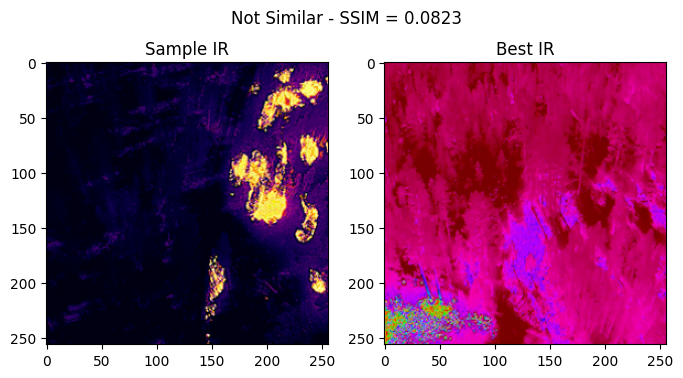

New Best IR found at idx = 986
Generated SSIM = 0.8536016345024109
Best IRS len = 2
Checking for idx = 46
SSIM = 0.0842


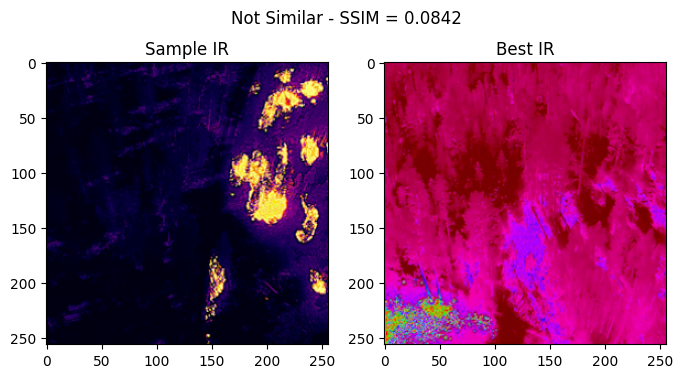

SSIM = 0.9647
Checking for idx = 880
SSIM = 0.0828


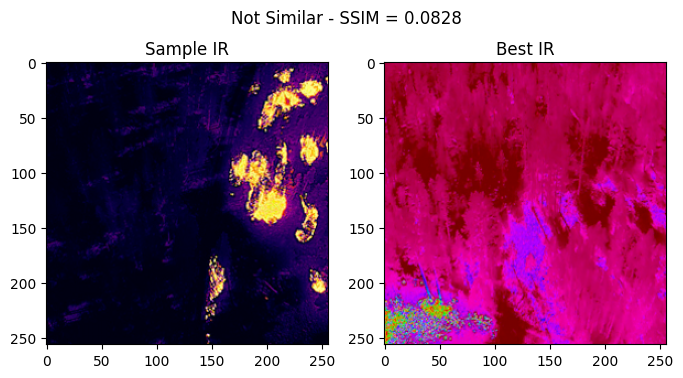

SSIM = 0.9961
Checking for idx = 556
SSIM = 0.0847


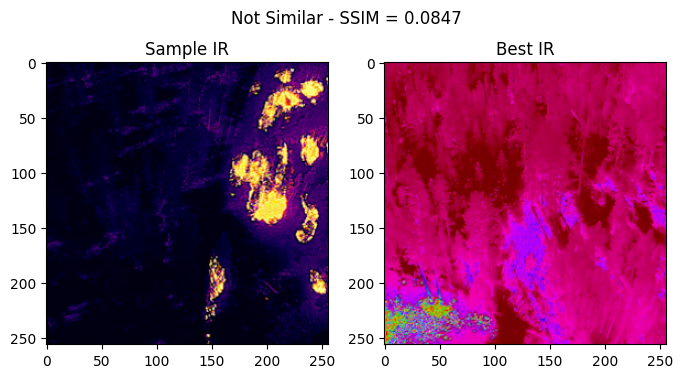

SSIM = 0.9585
Checking for idx = 197
SSIM = 0.2893
Checking for idx = 351
SSIM = 0.0840


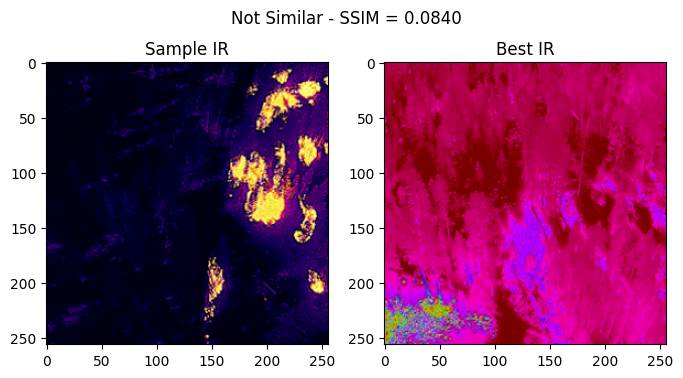

SSIM = 0.7893
Checking for idx = 945
SSIM = 0.6539
Checking for idx = 570
SSIM = 0.0857


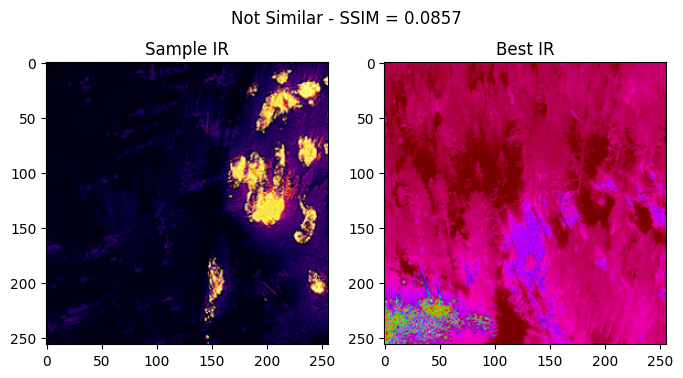

SSIM = 0.7676
Checking for idx = 489
SSIM = 0.0543


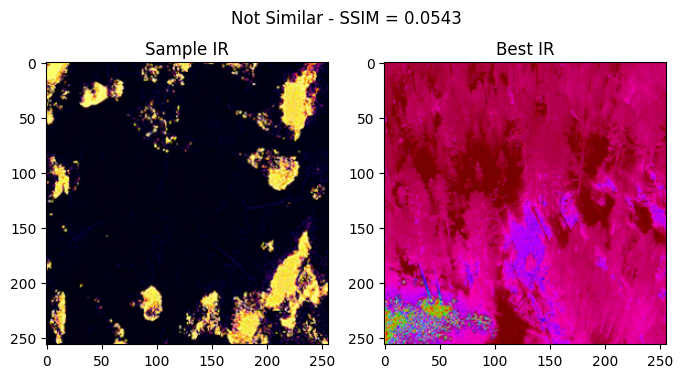

SSIM = 0.0880


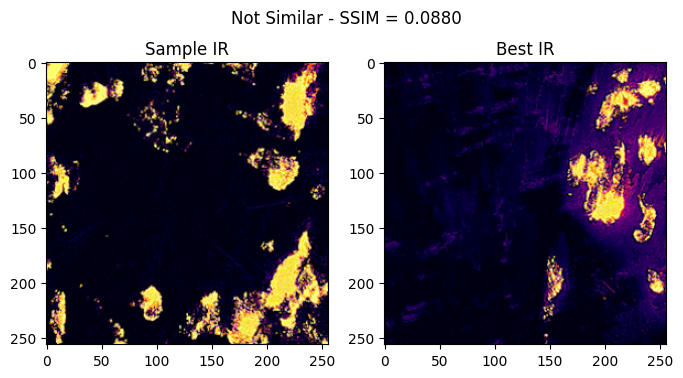

New Best IR found at idx = 489
Generated SSIM = 0.8330802917480469
Best IRS len = 3
Checking for idx = 972
SSIM = -0.0372


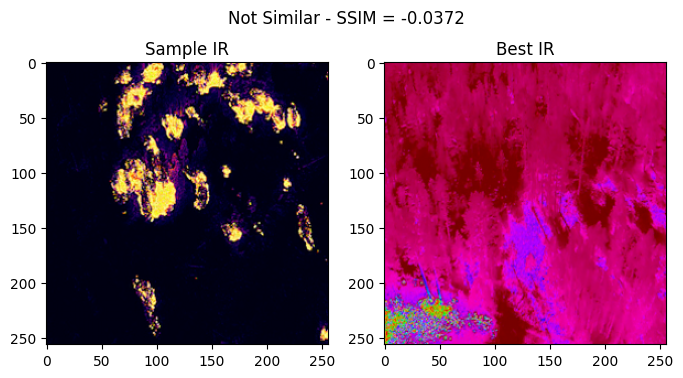

SSIM = -0.0007


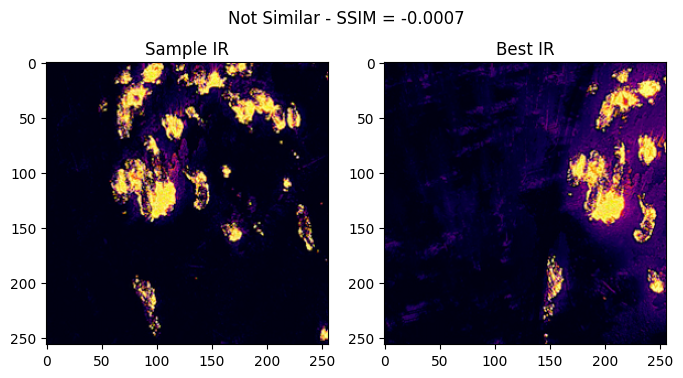

SSIM = 0.0439


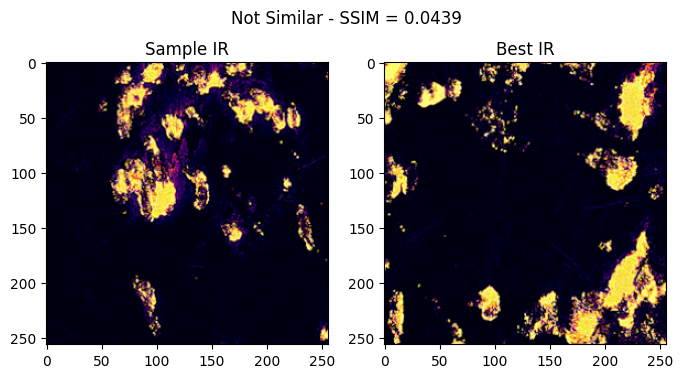

New Best IR found at idx = 972
Generated SSIM = 0.8317804336547852
Best IRS len = 4
Checking for idx = 421
SSIM = 0.0889


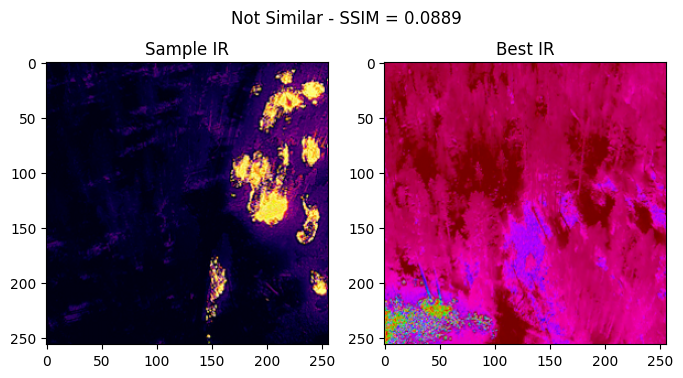

SSIM = 0.8490
Checking for idx = 846
SSIM = 0.0881


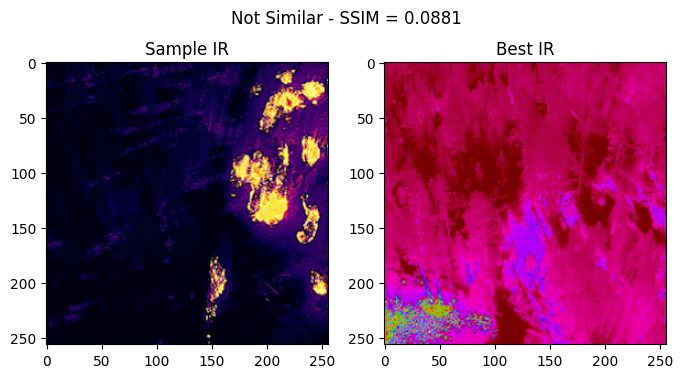

SSIM = 0.8483
Checking for idx = 462
SSIM = 0.1959


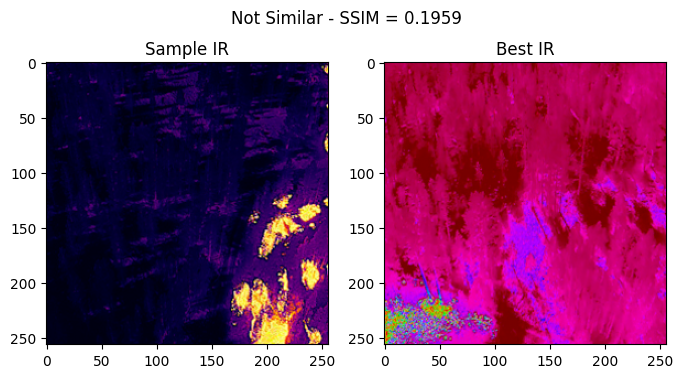

SSIM = 0.2196
Checking for idx = 753
SSIM = 0.0870


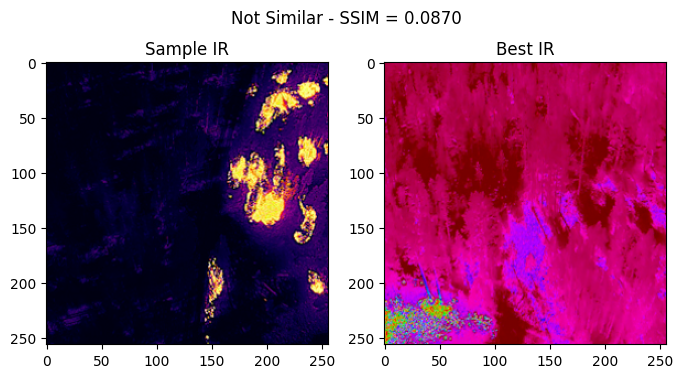

SSIM = 0.7524
Checking for idx = 890
SSIM = 0.0861


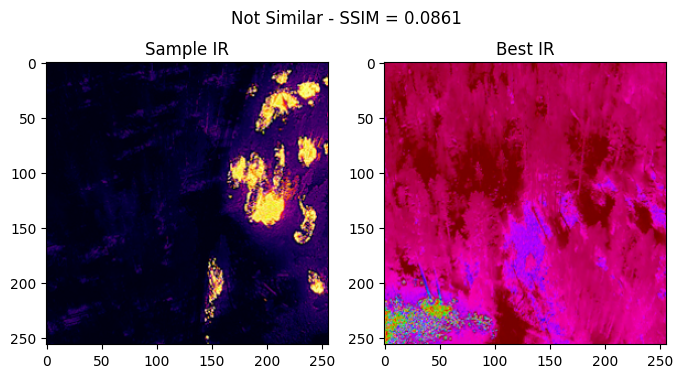

SSIM = 0.7493
Checking for idx = 159
SSIM = 0.0833


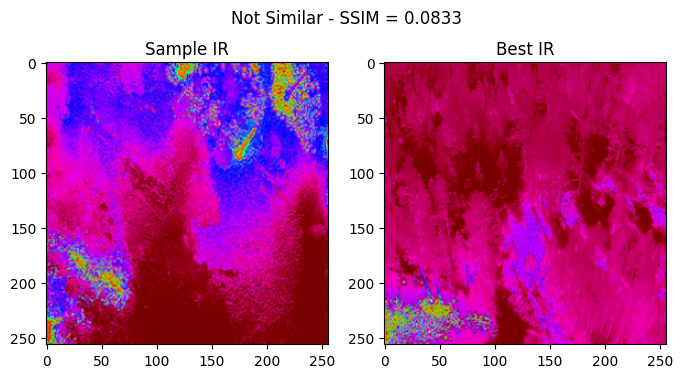

SSIM = 0.0380


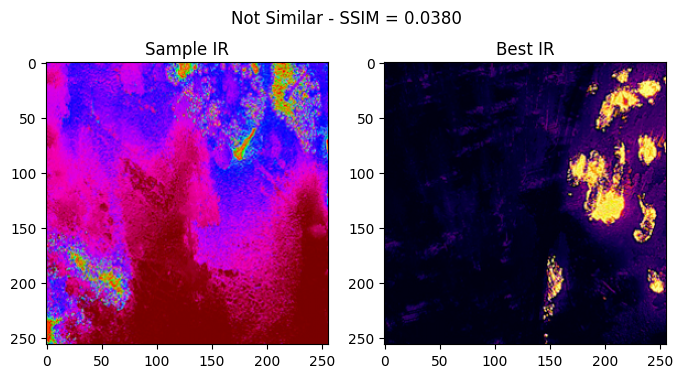

SSIM = 0.0104


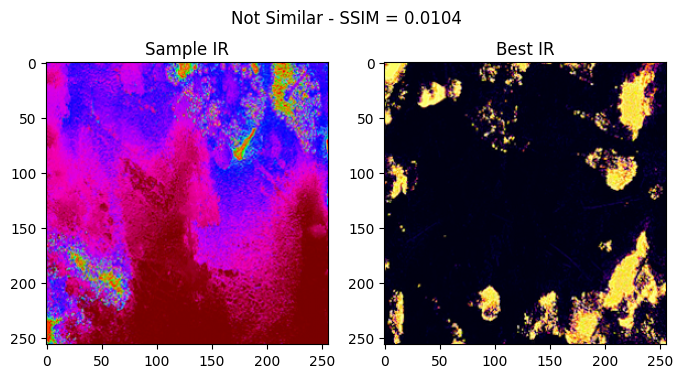

SSIM = 0.0002


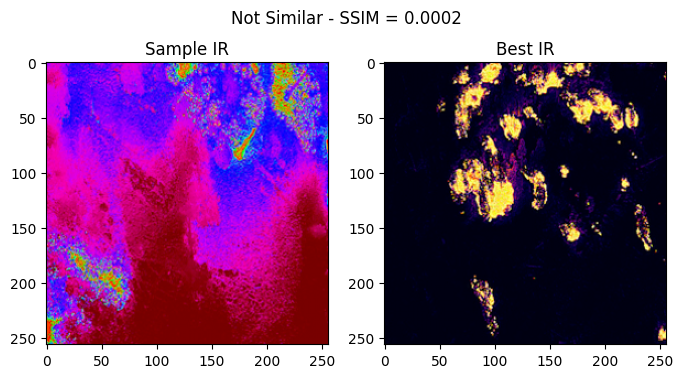

New Best IR found at idx = 159
Generated SSIM = 0.8267965316772461
Best IRS len = 5


In [130]:
best_rgbs,best_irs,best_prds,best_ssims = [],[],[],[]
best_rgbs.append(rgbs[scrs2.index[0]])
best_irs.append(irs[scrs2.index[0]])
best_prds.append(prds[scrs2.index[0]])
best_ssims.append(ssims[scrs2.index[0]])
for idx in scrs2.index[1:]:
    f = 0
    srgb,sirs,sprd,sssim = rgbs[idx],irs[idx],prds[idx],ssims[idx]
    print("Checking for idx =",idx)
    for bir in best_irs:
        sim = structural_similarity(bir, sirs, win_size=101, channel_axis=-1,data_range=sirs.max() - sirs.min())
        print(f"SSIM = {sim:.4f}")
        supt = f"Not Similar - SSIM = {sim:.4f}" if sim<0.2 else f"Similar - SSIM = {sim:.4f}"
        if sim>0.2:
            f = 1
            break
        else:
            plt.subplots(1,2,figsize=(8,4))
            plt.subplot(1,2,1)
            plt.imshow(sirs)
            plt.title("Sample IR")
            plt.subplot(1,2,2)
            plt.imshow(bir)
            plt.title("Best IR")
            plt.suptitle(supt)
            plt.show()
    if f==0:
        print("New Best IR found at idx =",idx)
        best_rgbs.append(rgbs[idx])
        best_irs.append(irs[idx])
        best_prds.append(prds[idx])
        best_ssims.append(ssims[idx])
        print(f"Generated SSIM = {ssims[idx]}")
        print("Best IRS len =",len(best_irs))
    if len(best_irs)==5:
        break

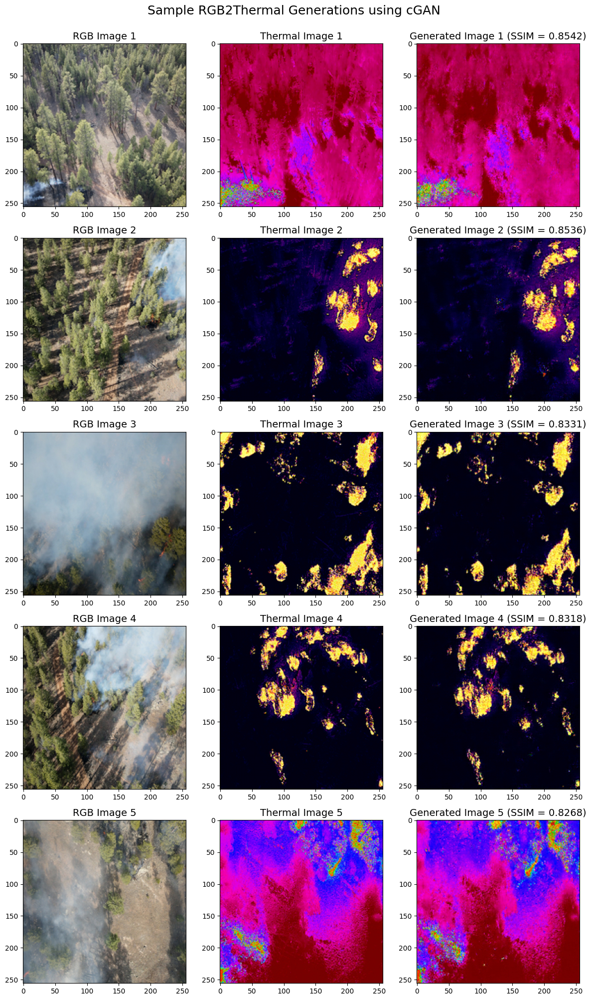

In [131]:
plt.subplots(5,3,figsize=(12,20))
idxs = range(1,16,3)
for i,brgb,bir,bprd,bssim in zip(idxs,best_rgbs,best_irs,best_prds,best_ssims):
    plt.subplot(5,3,i)
    plt.imshow(brgb)
    plt.title(f"RGB Image {(i+2)/3:.0f}",fontsize=14)
    plt.subplot(5,3,i+1)
    plt.imshow(bir)
    plt.title(f"Thermal Image {(i+2)/3:.0f}",fontsize=14)
    plt.subplot(5,3,i+2)
    plt.imshow(bprd)
    plt.title(f"Generated Image {(i+2)/3:.0f} (SSIM = {bssim:.4f})",fontsize=14)
plt.suptitle("Sample RGB2Thermal Generations using cGAN",y=1.00001,fontsize=18)
plt.tight_layout()
plt.show()

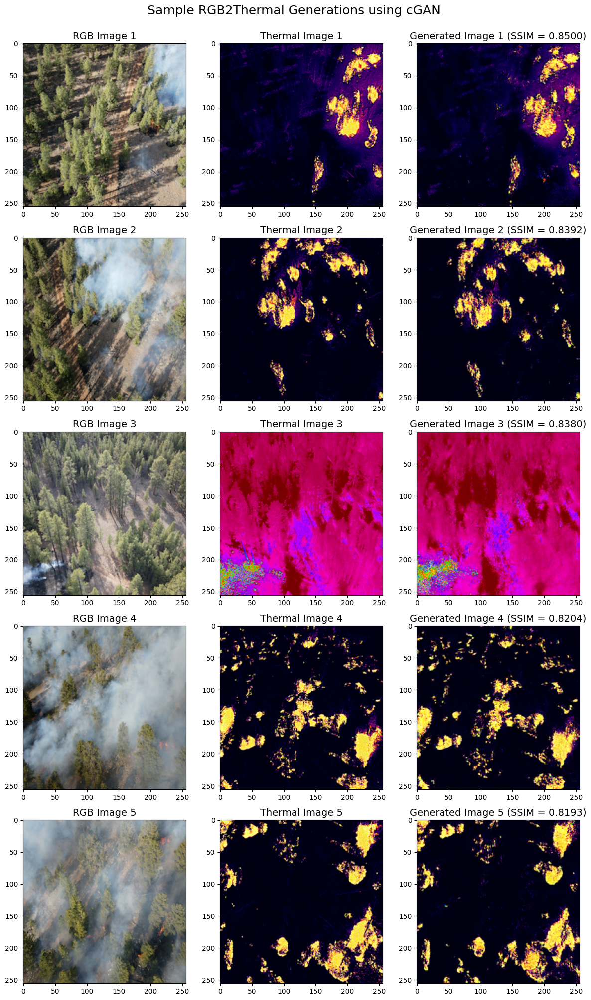

In [106]:
plt.subplots(5,3,figsize=(12,20))
idxs = range(1,16,3)
for i,brgb,bir,bprd,bssim in zip(idxs,best_rgbs,best_irs,best_prds,best_ssims):
    plt.subplot(5,3,i)
    plt.imshow(brgb)
    plt.title(f"RGB Image {(i+2)/3:.0f}",fontsize=14)
    plt.subplot(5,3,i+1)
    plt.imshow(bir)
    plt.title(f"Thermal Image {(i+2)/3:.0f}",fontsize=14)
    plt.subplot(5,3,i+2)
    plt.imshow(bprd)
    plt.title(f"Generated Image {(i+2)/3:.0f} (SSIM = {bssim:.4f})",fontsize=14)
plt.suptitle("Sample RGB2Thermal Generations using cGAN",y=1.00001,fontsize=18)
plt.tight_layout()
plt.show()

In [132]:
scrs3 = scrs[scrs['Frame No.']>13700].sort_values(by='SSIM')
scrs3.head()

,MSE,PSNR,SSIM,MAE,RGB_Paths,IR_Paths,Frame No.
451,0.052387,15.779790,0.080307,0.133926,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,30425
750,0.031497,17.133314,0.118963,0.081506,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,19757
370,0.031249,17.960704,0.121807,0.078162,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,30548
561,0.033783,17.903156,0.139728,0.095246,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,30518
587,0.040549,17.013561,0.155584,0.125848,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,/kaggle/input/flame2-rgb-ir-frame-pairs/254p F...,20218


Checking for idx = 750
SSIM = 0.0009


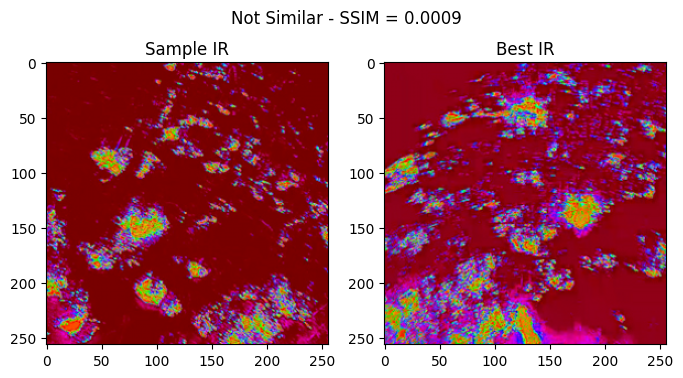

New Worst IR found at idx = 750
Generated SSIM = 0.11896272748708725
Worst IRS len = 2
Checking for idx = 370
SSIM = 0.0380


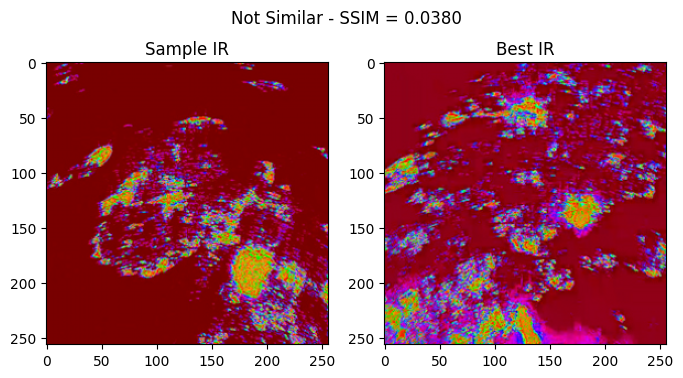

SSIM = 0.0340


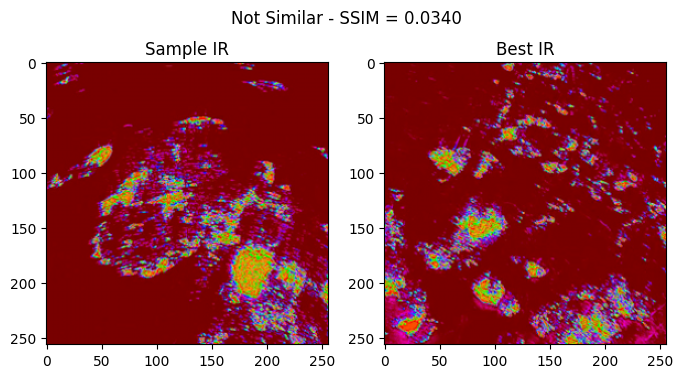

New Worst IR found at idx = 370
Generated SSIM = 0.12180737406015396
Worst IRS len = 3
Checking for idx = 561
SSIM = 0.0012


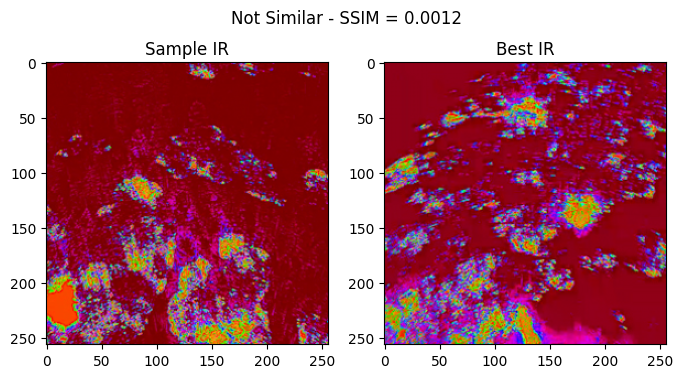

SSIM = 0.0377


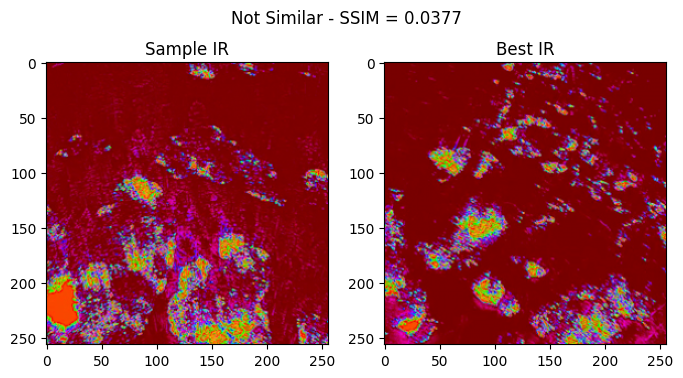

SSIM = 0.0586


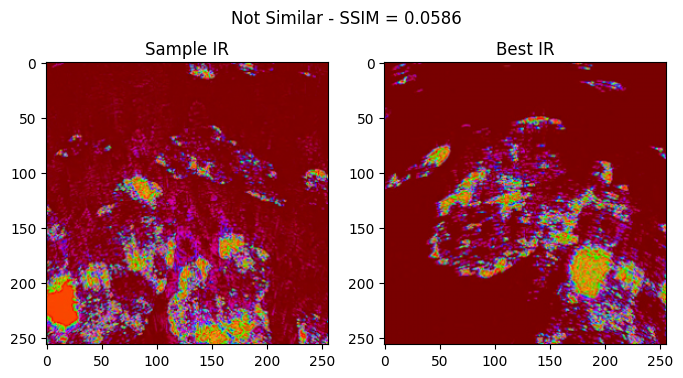

New Worst IR found at idx = 561
Generated SSIM = 0.13972826302051544
Worst IRS len = 4
Checking for idx = 587
SSIM = 0.0306


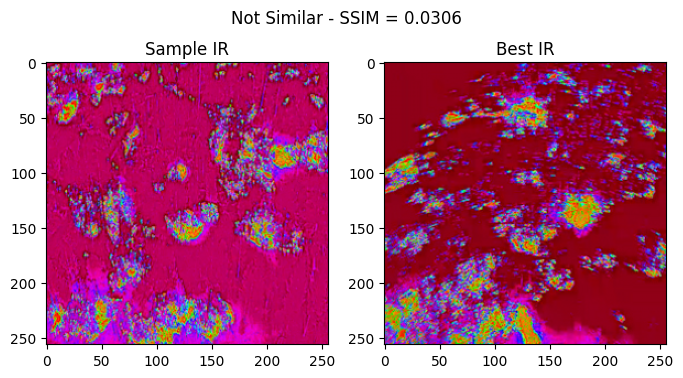

SSIM = 0.0122


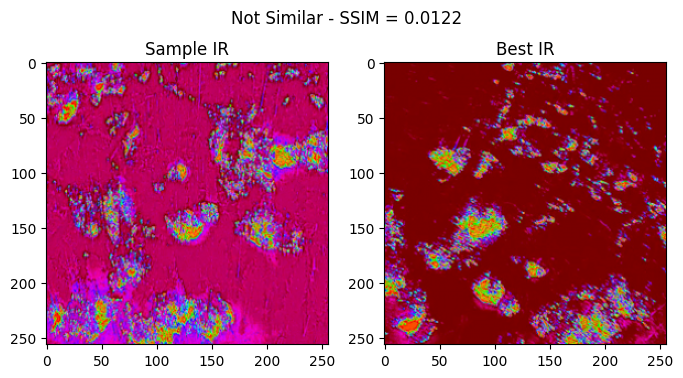

SSIM = 0.0160


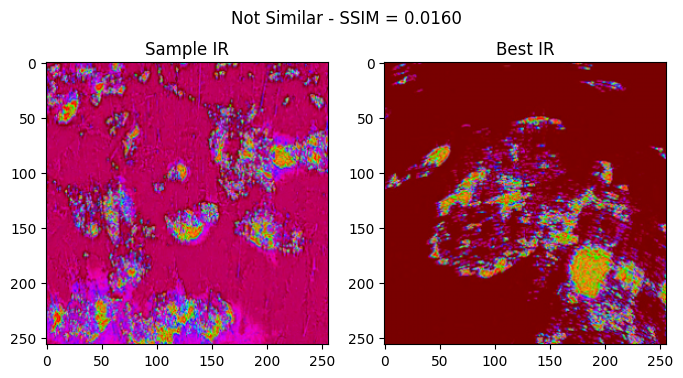

SSIM = 0.0126


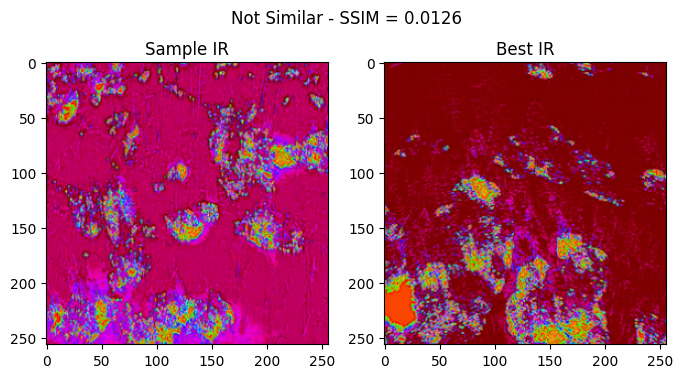

New Worst IR found at idx = 587
Generated SSIM = 0.15558366477489471
Worst IRS len = 5


In [133]:
worst_rgbs,worst_irs,worst_prds,worst_ssims = [],[],[],[]
worst_rgbs.append(rgbs[scrs3.index[0]])
worst_irs.append(irs[scrs3.index[0]])
worst_prds.append(prds[scrs3.index[0]])
worst_ssims.append(ssims[scrs3.index[0]])
for idx in scrs3.index[1:]:
    f = 0
    srgb,sirs,sprd,sssim = rgbs[idx],irs[idx],prds[idx],ssims[idx]
    print("Checking for idx =",idx)
    for wir in worst_irs:
        sim = structural_similarity(wir, sirs, win_size=101, channel_axis=-1,data_range=sirs.max() - sirs.min())
        print(f"SSIM = {sim:.4f}")
        supt = f"Not Similar - SSIM = {sim:.4f}" if sim<0.2 else f"Similar - SSIM = {sim:.4f}"
        if sim>0.2:
            f = 1
            break
        else:
            plt.subplots(1,2,figsize=(8,4))
            plt.subplot(1,2,1)
            plt.imshow(sirs)
            plt.title("Sample IR")
            plt.subplot(1,2,2)
            plt.imshow(wir)
            plt.title("Best IR")
            plt.suptitle(supt)
            plt.show()
    if f==0:
        print("New Worst IR found at idx =",idx)
        worst_rgbs.append(rgbs[idx])
        worst_irs.append(irs[idx])
        worst_prds.append(prds[idx])
        worst_ssims.append(ssims[idx])
        print(f"Generated SSIM = {ssims[idx]}")
        print("Worst IRS len =",len(worst_irs))
    if len(worst_irs)==5:
        break

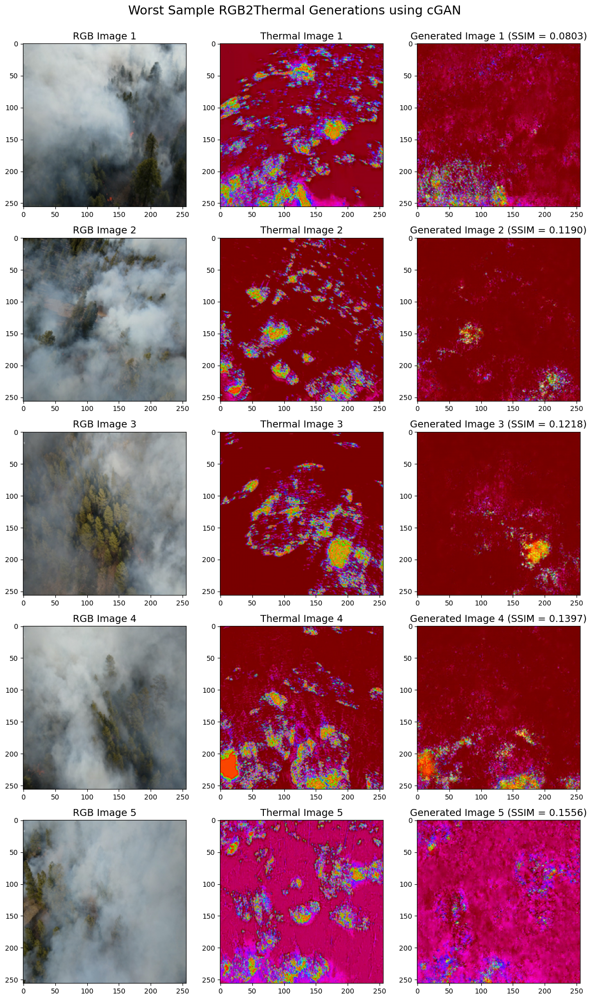

In [134]:
plt.subplots(5,3,figsize=(12,20))
idxs = range(1,16,3)
for i,wrgb,wir,wprd,wssim in zip(idxs,worst_rgbs,worst_irs,worst_prds,worst_ssims):
    plt.subplot(5,3,i)
    plt.imshow(wrgb)
    plt.title(f"RGB Image {(i+2)/3:.0f}",fontsize=14)
    plt.subplot(5,3,i+1)
    plt.imshow(wir)
    plt.title(f"Thermal Image {(i+2)/3:.0f}",fontsize=14)
    plt.subplot(5,3,i+2)
    plt.imshow(wprd)
    plt.title(f"Generated Image {(i+2)/3:.0f} (SSIM = {wssim:.4f})",fontsize=14)
plt.suptitle("Worst Sample RGB2Thermal Generations using cGAN",y=1.00001,fontsize=18)
plt.tight_layout()
plt.show()

In [9]:
def plot_cdf(scores, name, dset, figsize=(8, 6)):
    scores = np.sort(np.array(scores))
    cdf = np.arange(1, len(scores) + 1) / len(scores) * 100
    plt.figure(figsize=figsize)
    plt.plot(scores, cdf, marker='.', linestyle='-')
    plt.xlabel(name)
    plt.ylabel('Cumulative Percentage (%)')
    plt.title(f"Cumulative Distribution of {name} scores on {dset} set")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

In [11]:
fids = np.arange(1, 53452)
np.random.shuffle(fids)
train_size = int(0.7 * len(fids))
val_size = int(0.2 * len(fids))
test_size = len(fids) - train_size - val_size 

train_fids = fids[:train_size]
val_fids = fids[train_size:train_size + val_size]
test_fids = fids[train_size + val_size:]
print(f"Train: {len(train_fids)}, Validation: {len(val_fids)}, Test: {len(test_fids)}")

Train: 37415, Validation: 10690, Test: 5346


In [21]:
mses2, psnrs2, ssims2, maes2, _, _, _, _, _ = evaluate_model_tfdata(frameids=test_fids, batch_size=32)
print(f"Mean MSE = {np.mean(mses2):.4f}")
print(f"Mean MAE = {np.mean(maes2):.4f}")
print(f"Mean PSNR = {np.mean(psnrs2):.2f} dB")
print(f"Mean SSIM = {np.mean(ssims2):.4f}")

168it [17:18,  6.18s/it]                         

Mean MSE = 0.0195
Mean MAE = 0.0760
Mean PSNR = 20.83 dB
Mean SSIM = 0.6546


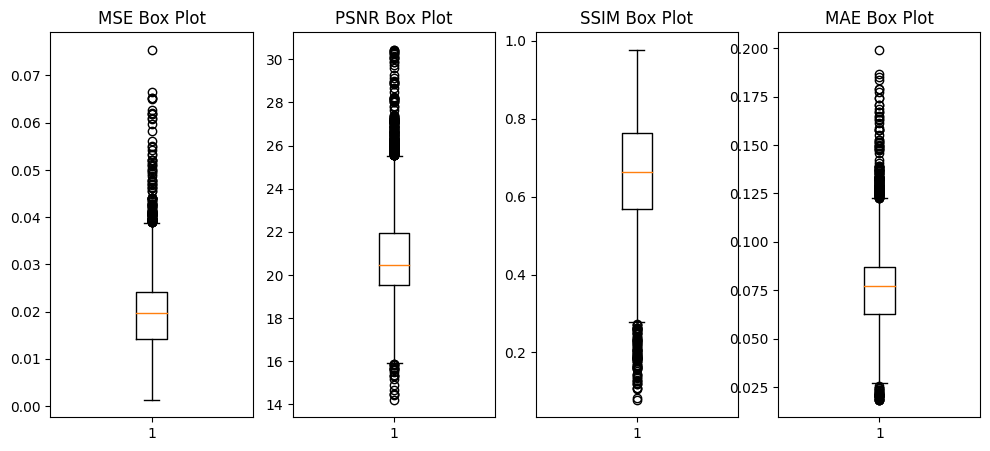

In [26]:
plot_boxplots(mses2,psnrs2,ssims2,maes2)

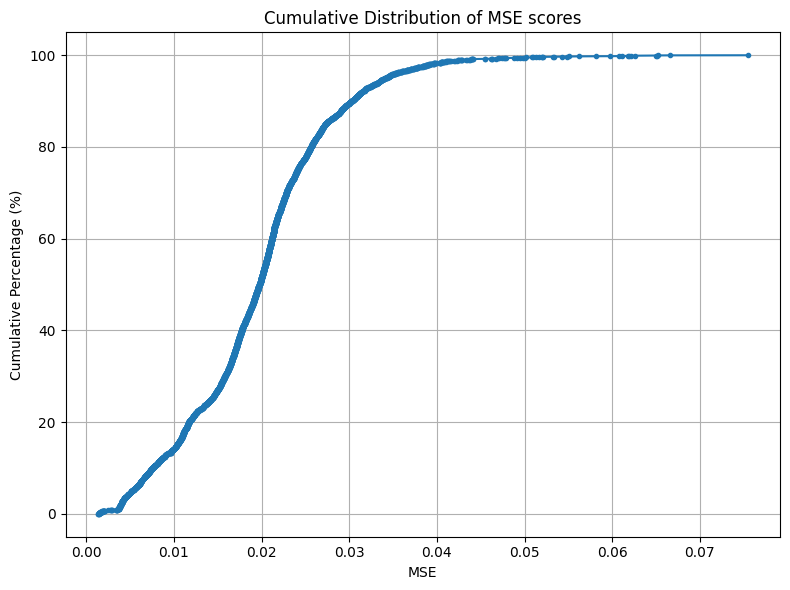

In [28]:
plot_cdf(mses2,'MSE')

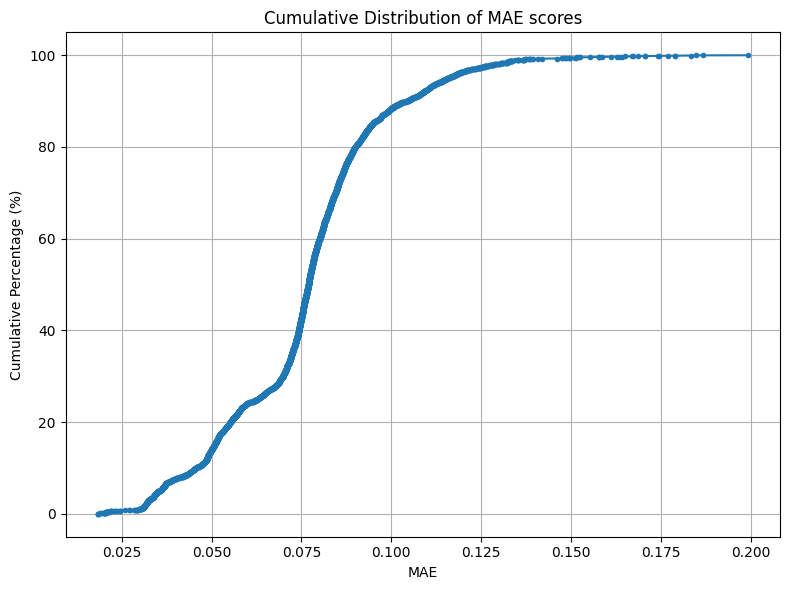

In [29]:
plot_cdf(maes2,'MAE')

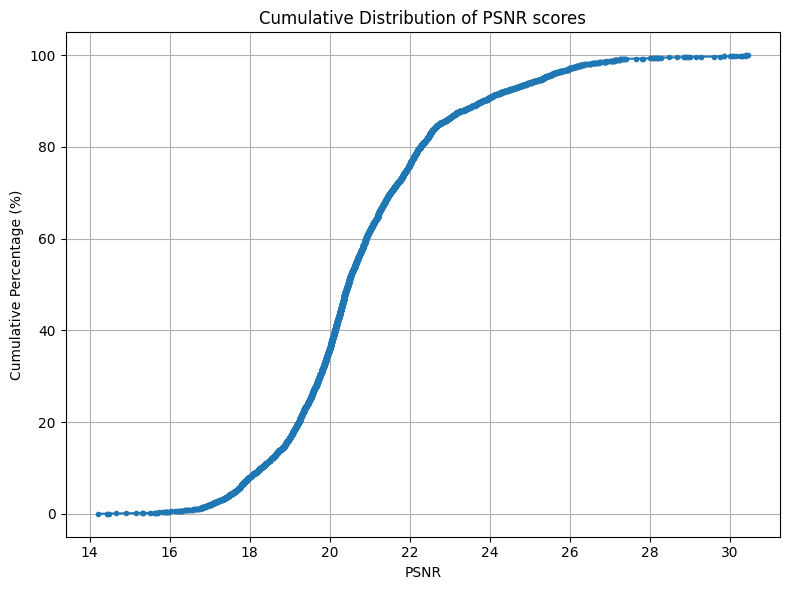

In [31]:
plot_cdf(psnrs2,'PSNR')

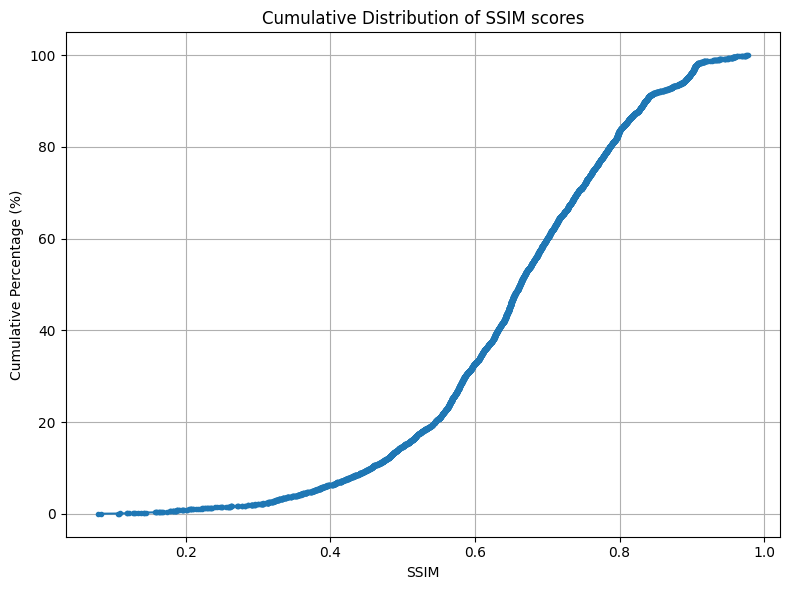

In [32]:
plot_cdf(ssims2,'SSIM')

In [10]:
fids = np.arange(1, 53452)
train_size = int(0.7 * len(fids))
val_size = int(0.2 * len(fids))
test_size = len(fids) - train_size - val_size 

train_fids = np.random.choice(fids, size=train_size, replace=False)
rest_fids = np.setdiff1d(fids, train_fids)
val_fids = np.random.choice(rest_fids, size=val_size, replace=False)
test_fids = np.setdiff1d(rest_fids, val_fids)
print(f"Train: {len(train_fids)}, Validation: {len(val_fids)}, Test: {len(test_fids)}")

Train: 37415, Validation: 10690, Test: 5346


In [11]:
mses3, psnrs3, ssims3, maes3, _, _, _, _, _ = evaluate_model_tfdata(frameids=val_fids, batch_size=32)
print(f"Mean MSE = {np.mean(mses3):.4f}")
print(f"Mean MAE = {np.mean(maes3):.4f}")
print(f"Mean PSNR = {np.mean(psnrs3):.2f} dB")
print(f"Mean SSIM = {np.mean(ssims3):.4f}")

335it [33:01,  5.92s/it]                         

Mean MSE = 0.0196
Mean MAE = 0.0762
Mean PSNR = 20.82 dB
Mean SSIM = 0.6526


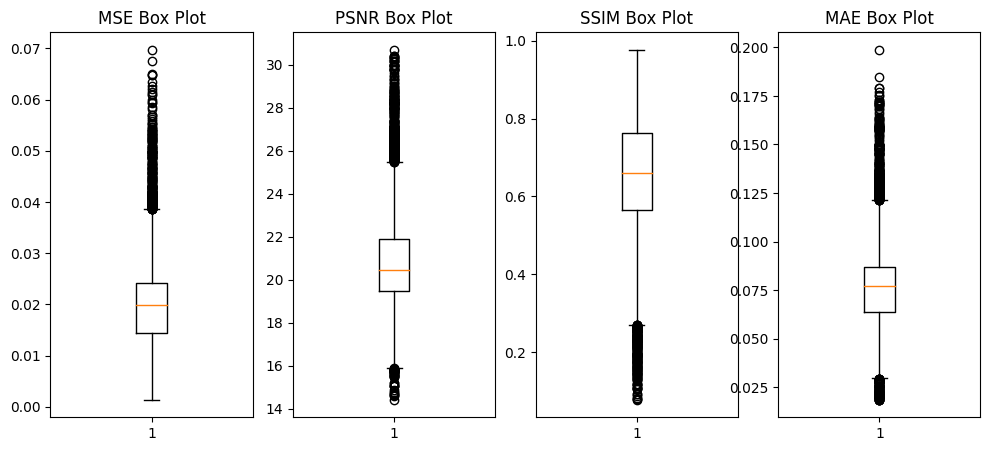

In [12]:
plot_boxplots(mses3,psnrs3,ssims3,maes3)

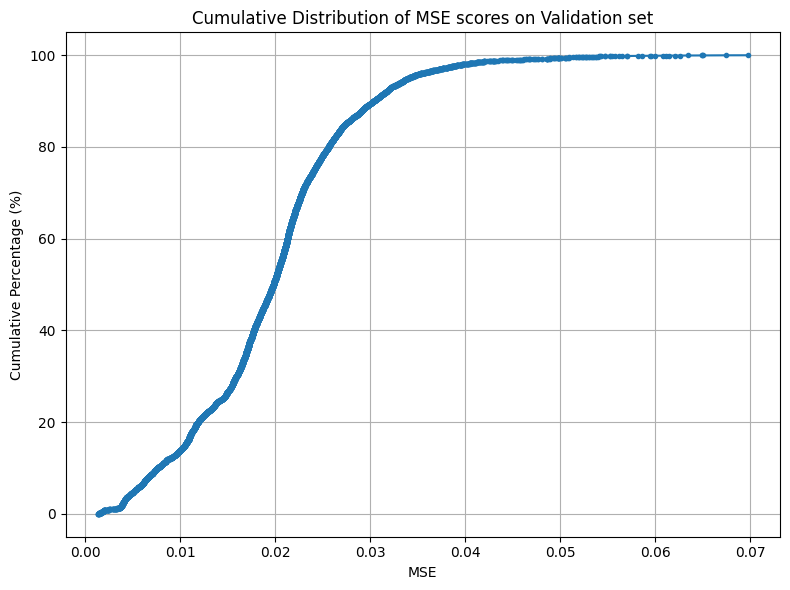

In [13]:
plot_cdf(mses3,'MSE',dset='Validation')

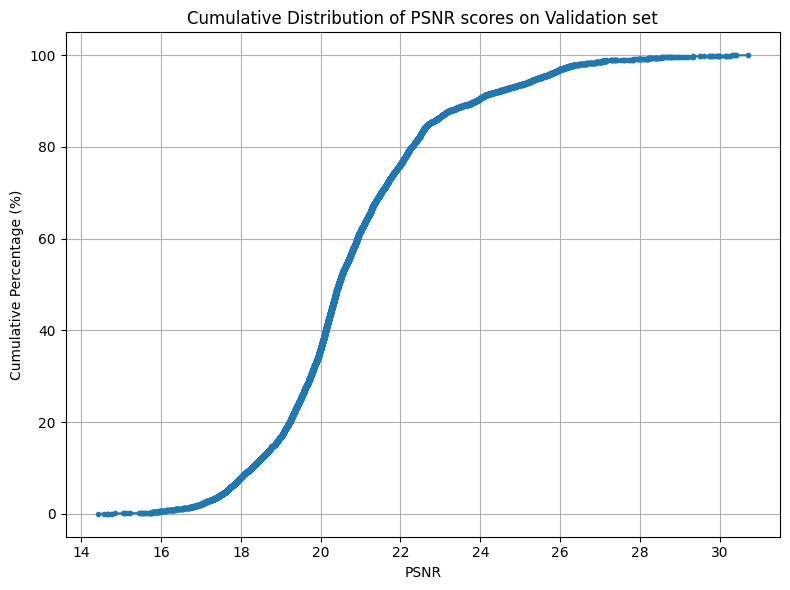

In [14]:
plot_cdf(psnrs3,'PSNR',dset='Validation')

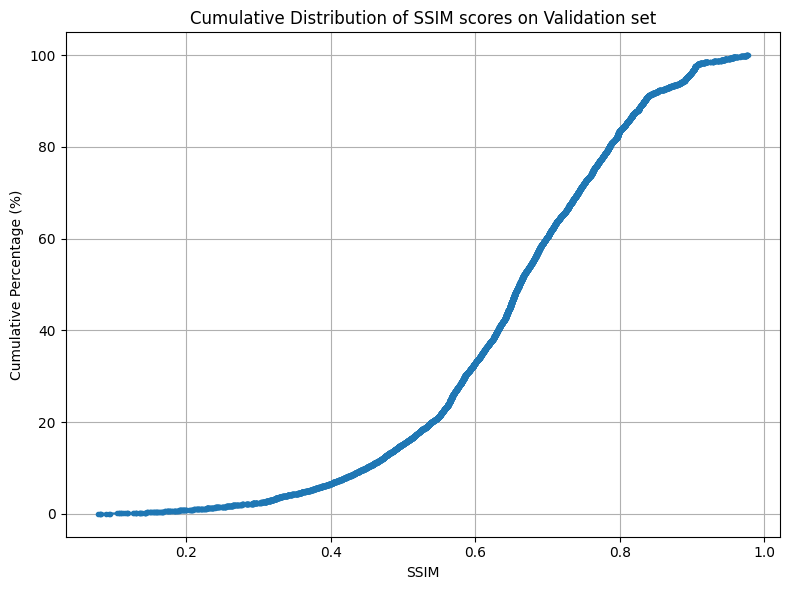

In [15]:
plot_cdf(ssims3,'SSIM',dset='Validation')

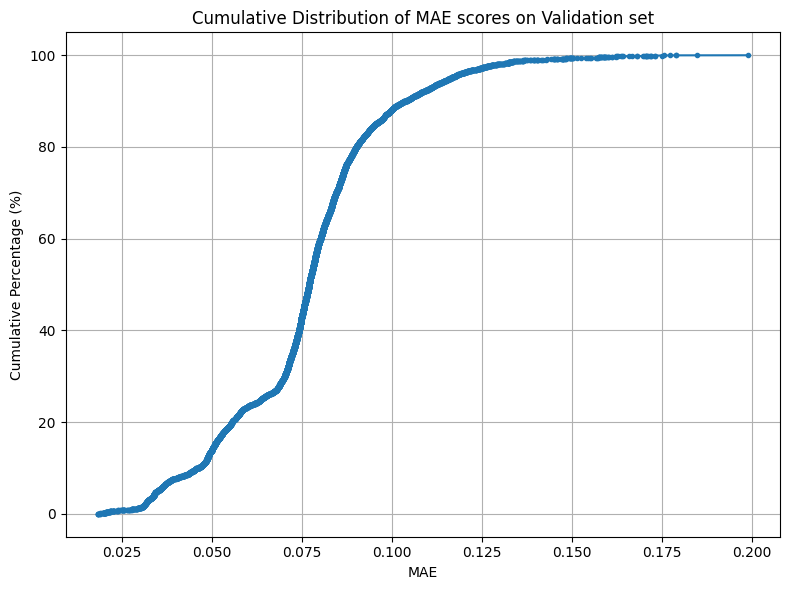

In [16]:
plot_cdf(maes3,'MAE',dset='Validation')